<a href="https://colab.research.google.com/github/miguel-source/AI4CCEE_Fall_2024/blob/main/D9_Solution.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# Schmitz, Sophia J
# Al-Ruqti, Suad Hamdan Ahmad
# Diaz Garcia, Miguel A

### Problem D3

In [ ]:
import math
import sympy as sp
from scipy.optimize import fsolve
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from matplotlib.animation import FuncAnimation

In [ ]:

# Input values
Qo = 250  # Pumping rate (m³/day)
H = 30  # Initial saturated thickness (m)
s = 7 # m
Q = 450 # m^3/d
hmax = 23 # m

# Coordinates for wells
pump_x, pump_y = 150, 175  # Pumping well
obs1_x, obs1_y = 50, 50  # Observation well 1
obs2_x, obs2_y = 150, 100  # Observation well 2

# Drawdowns at observation wells
s1 = 0.39  # Drawdown at observation well 1 (m)
s2 = 0.59  # Drawdown at observation well 2 (m)

Distances observation wells

In [ ]:
# Calculate distances from the pumping well to the observation wells
r1 = math.sqrt((pump_x - obs1_x)**2 + (pump_y - obs1_y)**2)  # Distance to observation well 1
r2 = math.sqrt((pump_x - obs2_x)**2 + (pump_y - obs2_y)**2)  # Distance to observation well 2

# Print distances for verification
print(f"Distance to Observation Well 1 (r1): {r1:.2f} m")
print(f"Distance to Observation Well 2 (r2): {r2:.2f} m")

Distance to Observation Well 1 (r1): 160.08 m
Distance to Observation Well 2 (r2): 75.00 m


#### Define the System of Equations


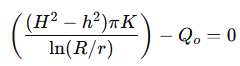

In [ ]:
# Define the system of equations
def equations(vars):
    K, R = vars  # Variables to solve for
    eq1 = ((H**2 - (H - s1)**2) * np.pi * K / np.log(R / r1)) - Qo
    eq2 = ((H**2 - (H - s2)**2) * np.pi * K / np.log(R / r2)) - Qo
    return [eq1, eq2]


#### Solve the System of Equations

In [ ]:
# Initial guesses for K and R
initial_guess = [5, 700]  # Reasonable starting values

# Solve the system numerically
K_val, R_val = fsolve(equations, initial_guess)

# Print results
print(f"Hydraulic Conductivity (K): {K_val:.2f} m/day")
print(f"Radius of Influence (R): {R_val:.2f} m")


Hydraulic Conductivity (K): 5.11 m/day
Radius of Influence (R): 712.57 m


#### Initial setup

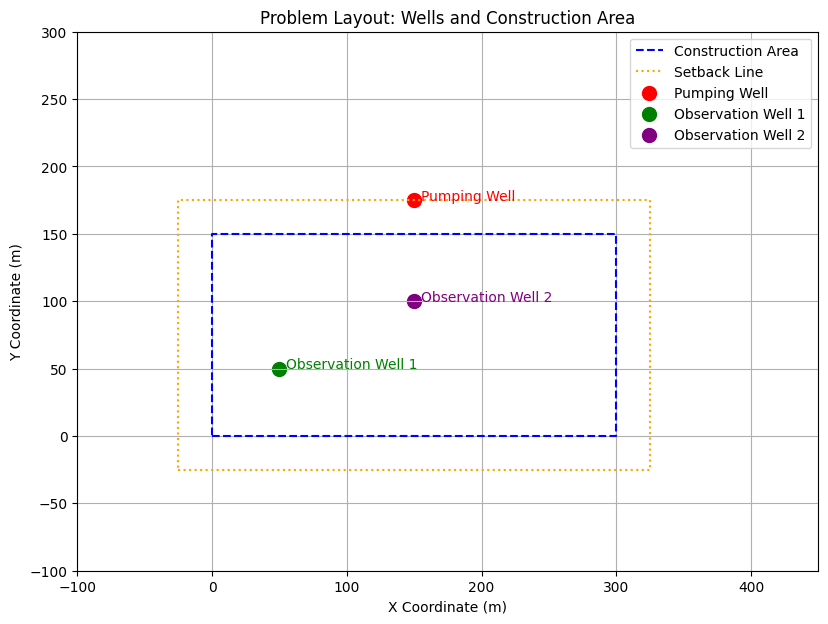

In [ ]:

# Define plot elements
construction_area = [(0, 0), (300, 0), (300, 150), (0, 150), (0, 0)]  # Construction area boundaries
setback_x = [-25, 325, 325, -25, -25]  # Setback line x-coordinates (25 m from construction boundary)
setback_y = [-25, -25, 175, 175, -25]  # Setback line y-coordinates (25 m from construction boundary)

# Plotting
plt.figure(figsize=(10, 7))

# Plot construction area
construction_x, construction_y = zip(*construction_area)
plt.plot(construction_x, construction_y, label="Construction Area", linestyle='--', color='blue')

# Plot setback line
plt.plot(setback_x, setback_y, label="Setback Line", linestyle=':', color='orange')

# Plot pumping well
plt.scatter(pump_x, pump_y, color='red', label="Pumping Well", s=100)

# Plot observation wells
plt.scatter(obs1_x, obs1_y, color='green', label="Observation Well 1", s=100)
plt.scatter(obs2_x, obs2_y, color='purple', label="Observation Well 2", s=100)

# Add labels
plt.text(pump_x + 5, pump_y, "Pumping Well", color='red')
plt.text(obs1_x + 5, obs1_y, "Observation Well 1", color='green')
plt.text(obs2_x + 5, obs2_y, "Observation Well 2", color='purple')

# Customize plot
plt.title("Problem Layout: Wells and Construction Area")
plt.xlabel("X Coordinate (m)")
plt.ylabel("Y Coordinate (m)")
plt.legend()
plt.grid(True)
plt.xlim(-100, 450)
plt.ylim(-100, 300)
plt.gca().set_aspect('equal', adjustable='box')

# Show plot
plt.show()


### Input N wells calculation

In [ ]:
# Step 1: Constants and parameters
H = 30  # Saturated thickness (m)
h_max = 23  # Maximum water table height after lowering (m)
S_max = H - h_max  # Maximum drawdown (m)
K = 5.11  # Hydraulic conductivity (m/day)
R = 712.57  # Radius of influence (m)
Q_max_per_well = 450  # Maximum pumping rate per well (m³/day)
min_drawdown_point = (0, 75)  # Minimum drawdown point coordinates
existing_well = (150, 175)  # Existing pumping well

# Define setback line (boundary for well placement)
setback_line = [(-25, -25), (325, -25), (325, 175), (-25, 175)]  # Setback line corners

#### Flow equation

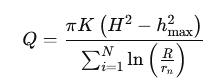

In [ ]:
# Step 2: Define the flow rate equation

def calculate_flow_rate(N, well_coords):
    # Calculate distances from each well to the minimum drawdown point
    r_n = [np.sqrt((x - min_drawdown_point[0])**2 + (y - min_drawdown_point[1])**2) for x, y in well_coords]
    # Calculate the denominator of the equation
    denominator = np.sum(np.log(R / np.array(r_n)))
    # Calculate Q using the provided formula
    Q = (np.pi * K * (H**2 - h_max**2)) / denominator
    return Q

#### Water table elevation h

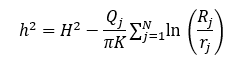

In [ ]:
# Function to calculate h

def calculate_h(Q_total, well_coords, r_n_list):
    summation_ln = np.sum([np.log(R / r_n) for r_n in r_n_list])
    h_squared = H**2 - (Q_total / (np.pi * K)) * summation_ln
    return np.sqrt(h_squared)


####Wells Coordinates

In [ ]:
# Define well coordinates and the minimum drawdown point

wells = {

    "Existing_Well_1": (150, 175),
    "P_Well_2": (75, -25),
    "P_Well_3": (250, -25),
    "P_Well_4": (325, 10),
    "P_Well_5": (325, 90),
    "P_Well_6": (290, 175),
    "P_Well_7": (10, 175),
    "P_Well_8": (-25, 90),
    "P_Well_9": (-25, 10),
}



min_drawdown_point = (150, 75)  # Minimum drawdown point coordinates

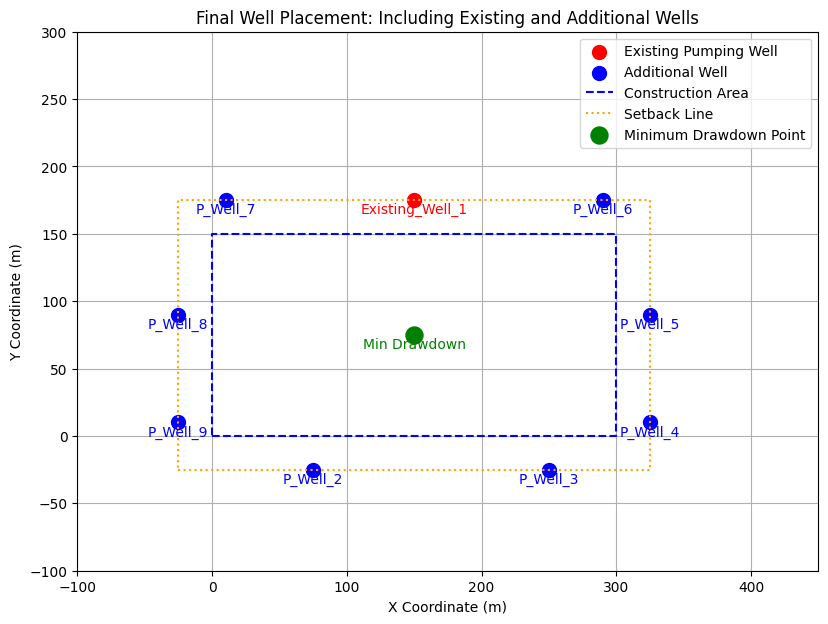

In [ ]:
# Plotting
plt.figure(figsize=(10, 7))

# Plot each well
for well_name, (x, y) in wells.items():
    if well_name == "Existing_Well_1":
        plt.scatter(x, y, color='red', s=100, label="Existing Pumping Well")
        plt.text(x, y - 10, well_name, color='red', ha='center')
    else:
        plt.scatter(x, y, color='blue', s=100, label="Additional Well" if well_name == "P_Well_2" else None)
        plt.text(x, y - 10, well_name, color='blue', ha='center')
# Plot construction area
construction_x, construction_y = zip(*construction_area)
plt.plot(construction_x, construction_y, label="Construction Area", linestyle='--', color='blue')

# Plot setback line
plt.plot(setback_x, setback_y, label="Setback Line", linestyle=':', color='orange')


plt.scatter(*min_drawdown_point, color='green', s=150, label="Minimum Drawdown Point")
plt.text(min_drawdown_point[0], min_drawdown_point[1] - 10, "Min Drawdown", color='green', ha='center')



# Customize plot
plt.title("Final Well Placement: Including Existing and Additional Wells")
plt.xlabel("X Coordinate (m)")
plt.ylabel("Y Coordinate (m)")
plt.legend()
plt.grid(True)
plt.xlim(-100, 450)
plt.ylim(-100, 300)
plt.gca().set_aspect('equal', adjustable='box')

# Show plot
plt.show()

In [ ]:
# Calculate the distance (r) from each pumping well to the minimum drawdown point

distances = {well: math.sqrt((coords[0] - min_drawdown_point[0])**2 + (coords[1] - min_drawdown_point[1])**2)
             for well, coords in wells.items()}

print("Distances (r values):", distances)

Distances (r values): {'Existing_Well_1': 100.0, 'P_Well_2': 125.0, 'P_Well_3': 141.4213562373095, 'P_Well_4': 186.6815470259447, 'P_Well_5': 175.64168070250295, 'P_Well_6': 172.04650534085255, 'P_Well_7': 172.04650534085255, 'P_Well_8': 175.64168070250295, 'P_Well_9': 186.6815470259447}


In [ ]:
# Calculate h^2 using the provided equation
ln_terms = [np.log(R / r) for r in distances.values()]
h_squared = H**2 - (Q / (np.pi * K)) * sum(ln_terms)
h = np.sqrt(h_squared) if h_squared > 0 else 0  # Ensure h is non-negative

print(f"Calculated h: {h:.2f} m")

Calculated h: 22.75 m


In [ ]:
# Blue region boundaries
x_min, x_max = 0, 300
y_min, y_max = 0, 150
resolution = 5  # Resolution of the grid (distance between points)

# Create a grid of points
x_values = np.arange(x_min, x_max + resolution, resolution)
y_values = np.arange(y_min, y_max + resolution, resolution)
grid_x, grid_y = np.meshgrid(x_values, y_values)

# Given values
H = 30  # Initial saturated thickness (m)
Q = 450  # Pumping rate (m³/day)
K = K_val  # Hydraulic conductivity (m/day)
R = R_val  # Radius of influence (m)

# Calculate h at each grid point
h_matrix = np.zeros_like(grid_x, dtype=float)
for i in range(grid_x.shape[0]):
    for j in range(grid_x.shape[1]):
        gx, gy = grid_x[i, j], grid_y[i, j]

        # Calculate distance from the grid point to each well
        distances = [math.sqrt((gx - wx)**2 + (gy - wy)**2) for wx, wy in wells.values()]

        # Calculate h^2 using the provided equation
        ln_terms = [np.log(R / r) if r > 0 else 0 for r in distances]  # Avoid division by zero
        h_squared = H**2 - (Q / (np.pi * K)) * sum(ln_terms)
        h_matrix[i, j] = np.sqrt(h_squared) if h_squared > 0 else 0  # Ensure h is non-negative

# Find the minimum h value and its location
min_h_index = np.unravel_index(np.argmin(h_matrix), h_matrix.shape)
min_h_value = h_matrix[min_h_index]
min_h_coordinates = (grid_x[min_h_index], grid_y[min_h_index])
print(f"Minimum h: {min_h_value:.2f} m at point {min_h_coordinates}")


# Find the maximum h value and its location
min_h_index = np.unravel_index(np.argmax(h_matrix), h_matrix.shape)
min_h_value = h_matrix[min_h_index]
min_h_coordinates = (grid_x[min_h_index], grid_y[min_h_index])
print(f"Maximum h: {min_h_value:.2f} m at point {min_h_coordinates}")

Minimum h: 22.40 m at point (300, 85)
Maximum h: 23.01 m at point (160, 0)


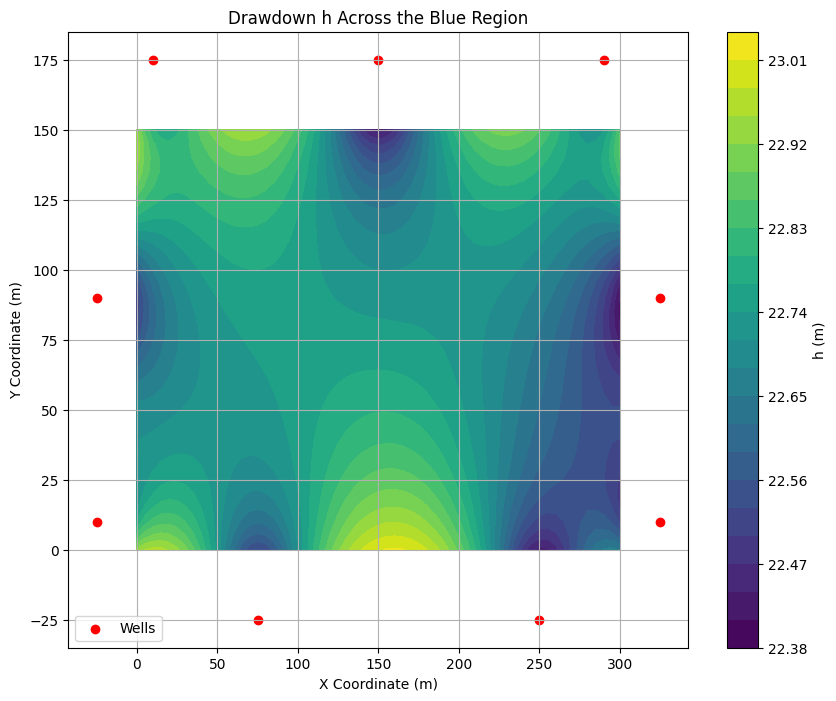

In [ ]:
# Plot the h values across the grid
plt.figure(figsize=(10, 8))
plt.contourf(grid_x, grid_y, h_matrix, cmap="viridis", levels=20)
plt.colorbar(label="h (m)")
plt.scatter(*zip(*wells.values()), color='red', label="Wells")  # Plot well locations
plt.title("Drawdown h Across the Blue Region")
plt.xlabel("X Coordinate (m)")
plt.ylabel("Y Coordinate (m)")
plt.legend()
plt.grid(True)
plt.show()

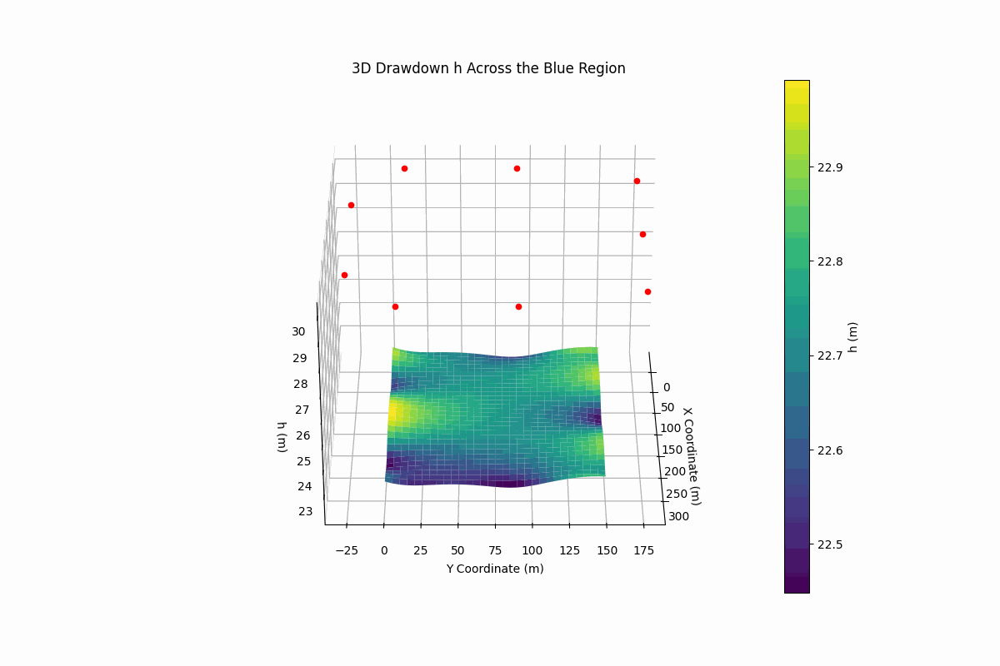

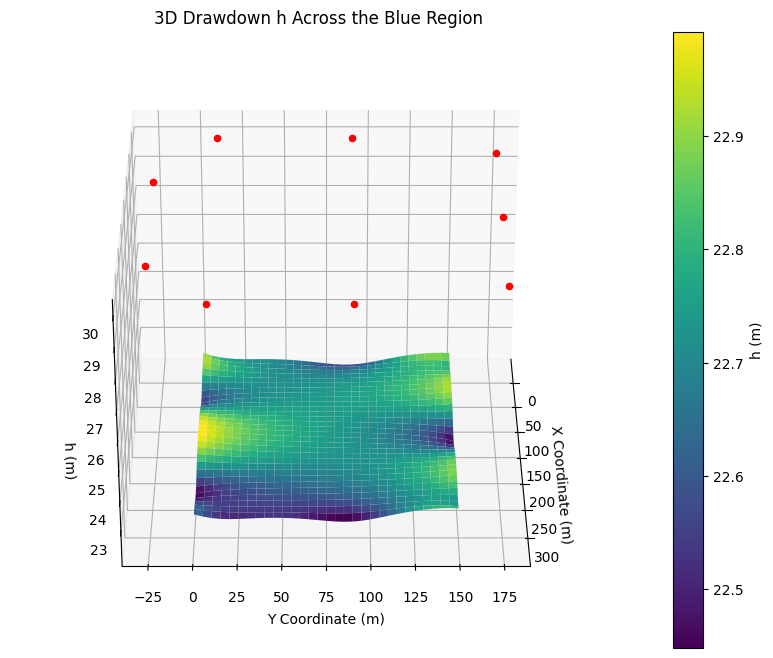

In [ ]:

# Blue region boundaries
x_min, x_max = 0, 300
y_min, y_max = 0, 150
resolution = 5  # Resolution of the grid (distance between points)

# Create a grid of points
x_values = np.arange(x_min, x_max + resolution, resolution)
y_values = np.arange(y_min, y_max + resolution, resolution)
grid_x, grid_y = np.meshgrid(x_values, y_values)

# Calculate h at each grid point
h_matrix = np.zeros_like(grid_x, dtype=float)
for i in range(grid_x.shape[0]):
    for j in range(grid_x.shape[1]):
        gx, gy = grid_x[i, j], grid_y[i, j]

        # Calculate distance from the grid point to each well
        distances = [math.sqrt((gx - wx)**2 + (gy - wy)**2) for wx, wy in wells.values()]

        # Calculate h^2 using the provided equation
        ln_terms = [np.log(R / r) if r > 0 else 0 for r in distances]  # Avoid division by zero
        h_squared = H**2 - (Q / (np.pi * K)) * sum(ln_terms)
        h_matrix[i, j] = np.sqrt(h_squared) if h_squared > 0 else 0  # Ensure h is non-negative

# Create the figure and 3D axes
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the surface
surf = ax.plot_surface(grid_x, grid_y, h_matrix, cmap="viridis", edgecolor='none')

# Plot well locations
for well_name, (wx, wy) in wells.items():
    ax.scatter(wx, wy, 30, color='red', label="Wells" if well_name == "Existing_Well_1" else None)  # Z=30 for display

# Customize plot
ax.set_title("3D Drawdown h Across the Blue Region")
ax.set_xlabel("X Coordinate (m)")
ax.set_ylabel("Y Coordinate (m)")
ax.set_zlabel("h (m)")
fig.colorbar(surf, ax=ax, label="h (m)")

# Rotate dynamically
def update(num):
    ax.view_init(elev=30, azim=num)

# Animation
ani = FuncAnimation(fig, update, frames=np.arange(0, 360, 1), interval=50)

# Save the animation as a GIF
ani.save('3D_drawdown_animation.gif', writer='pillow', fps=30)

# Display the GIF in Colab
from IPython.display import Image
Image(filename="3D_drawdown_animation.gif")

In [ ]:

# # Define the setback line
# setback_line = []
# # Bottom line (-25, -25) to (325, -25)
# for x in np.arange(-25, 326, 10):
#     setback_line.append((x, -25))
# # Right line (325, -25) to (325, 175)
# for y in np.arange(-25, 176, 10):
#     setback_line.append((325, y))
# # Top line (325, 175) to (-25, 175)
# for x in np.arange(325, -26, -10):
#     setback_line.append((x, 175))
# # Left line (-25, 175) to (-25, -25)
# for y in np.arange(175, -26, -10):
#     setback_line.append((-25, y))

# # Create a grid of points for the blue region
# x_min, x_max = 0, 300
# y_min, y_max = 0, 150
# resolution = 10  # Grid resolution
# x_values = np.arange(x_min, x_max + resolution, resolution)
# y_values = np.arange(y_min, y_max + resolution, resolution)
# grid_x, grid_y = np.meshgrid(x_values, y_values)

# # Function to calculate drawdown h for a grid
# def calculate_drawdown(well_locations):
#     h_matrix = np.zeros_like(grid_x, dtype=float)
#     for i in range(grid_x.shape[0]):
#         for j in range(grid_x.shape[1]):
#             gx, gy = grid_x[i, j], grid_y[i, j]

#             # Calculate distance from the grid point to each well
#             distances = [math.sqrt((gx - wx)**2 + (gy - wy)**2) for wx, wy in well_locations]

#             # Calculate h^2 using the provided equation
#             ln_terms = [np.log(R / r) if r > 0 else 0 for r in distances]  # Avoid division by zero
#             h_squared = H**2 - (Q / (np.pi * K)) * sum(ln_terms)
#             h_matrix[i, j] = np.sqrt(h_squared) if h_squared > 0 else 0  # Ensure h is non-negative
#     return h_matrix

# # Optimize well locations using 9 wells on the setback line
# best_locations = None
# min_max_h = float('inf')

# for well_combination in combinations(setback_line, 9):  # Iterate through all combinations of 9 wells
#     h_matrix = calculate_drawdown(well_combination)
#     max_h = np.max(h_matrix)
#     if max_h < 23 and max_h < min_max_h:
#         min_max_h = max_h
#         best_locations = well_combination

# # Output the results
# print(f"Optimal well locations: {best_locations}")
# print(f"Maximum drawdown (h) in the blue region: {min_max_h:.2f} m")
